## Proyecto 3 - Analítica Computacional para la Toma de Decisiones

#### Juan Pablo Ríos Hernández 201821819
#### Samuel Felipe Ríos Parra 201821820
#### Joep Cornelis Nicolaas van der Kamp 202416832

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go

## Tarea 1. Preguntas de negocio:

#### ¿Cuál va a ser el puntaje que va a obtener un estudiante dada su información académica y sociodemográfica?

#### ¿Cómo es la distribución histórica de los puntajes basados en factores sociodemográficos y académicos?

## Tarea 2. Limpieza y alistamiento de datos:

In [2]:
df = pd.read_csv('Datos_Santander.csv')
df

,PERIODO,ESTU_TIPODOCUMENTO,ESTU_CONSECUTIVO,COLE_AREA_UBICACION,COLE_BILINGUE,COLE_CALENDARIO,COLE_CARACTER,COLE_COD_DANE_ESTABLECIMIENTO,COLE_COD_DANE_SEDE,COLE_COD_DEPTO_UBICACION,...,FAMI_TIENECOMPUTADOR,FAMI_TIENEINTERNET,FAMI_TIENELAVADORA,DESEMP_INGLES,PUNT_INGLES,PUNT_MATEMATICAS,PUNT_SOCIALES_CIUDADANAS,PUNT_C_NATURALES,PUNT_LECTURA_CRITICA,PUNT_GLOBAL
0,20194,TI,SB11201940226736,URBANO,N,A,TÉCNICO/ACADÉMICO,1.680010e+11,1.680010e+11,68.0,...,Si,Si,Si,A2,61.0,64.0,49.0,59.0,63.0,295.0
1,20194,TI,SB11201940226736,URBANO,N,A,TÉCNICO/ACADÉMICO,1.680010e+11,1.680010e+11,68.0,...,Si,Si,Si,A2,61.0,64.0,49.0,59.0,63.0,295.0
2,20172,TI,SB11201720104447,URBANO,N,A,TÉCNICO/ACADÉMICO,1.683070e+11,1.683070e+11,68.0,...,No,No,Si,A-,47.0,59.0,64.0,59.0,68.0,307.0
3,20172,TI,SB11201720187961,URBANO,N,A,TÉCNICO/ACADÉMICO,1.685470e+11,1.685470e+11,68.0,...,No,Si,Si,A-,44.0,45.0,45.0,50.0,46.0,232.0
4,20194,CC,SB11201940041980,URBANO,N,A,TÉCNICO,1.682980e+11,1.682980e+11,68.0,...,No,NaN,Si,A-,46.0,52.0,45.0,28.0,53.0,223.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105547,20194,TI,SB11201940085543,URBANO,NaN,A,NaN,3.680010e+11,3.680010e+11,68.0,...,Si,Si,No,A1,52.0,46.0,44.0,45.0,44.0,227.0
105548,20172,CC,SB11201720092134,URBANO,N,A,TÉCNICO/ACADÉMICO,1.683680e+11,1.683680e+11,68.0,...,No,No,No,A-,43.0,47.0,52.0,51.0,59.0,258.0
105549,20194,TI,SB11201940034928,URBANO,N,A,TÉCNICO/ACADÉMICO,1.683200e+11,1.683200e+11,68.0,...,Si,Si,Si,A1,50.0,56.0,36.0,40.0,48.0,227.0
105550,20194,TI,SB11201940034928,URBANO,N,A,TÉCNICO/ACADÉMICO,1.683200e+11,1.683200e+11,68.0,...,Si,Si,Si,A1,50.0,56.0,36.0,40.0,48.0,227.0


In [3]:
df.dtypes

PERIODO                            int64
ESTU_TIPODOCUMENTO                object
ESTU_CONSECUTIVO                  object
COLE_AREA_UBICACION               object
COLE_BILINGUE                     object
COLE_CALENDARIO                   object
COLE_CARACTER                     object
COLE_COD_DANE_ESTABLECIMIENTO    float64
COLE_COD_DANE_SEDE               float64
COLE_COD_DEPTO_UBICACION         float64
COLE_COD_MCPIO_UBICACION         float64
COLE_CODIGO_ICFES                float64
COLE_DEPTO_UBICACION              object
COLE_GENERO                       object
COLE_JORNADA                      object
COLE_MCPIO_UBICACION              object
COLE_NATURALEZA                   object
COLE_NOMBRE_ESTABLECIMIENTO       object
COLE_NOMBRE_SEDE                  object
COLE_SEDE_PRINCIPAL               object
ESTU_COD_DEPTO_PRESENTACION      float64
ESTU_COD_MCPIO_PRESENTACION      float64
ESTU_COD_RESIDE_DEPTO            float64
ESTU_COD_RESIDE_MCPIO            float64
ESTU_DEPTO_PRESE

#### Missing Values

In [4]:
df.isna().sum()

PERIODO                              0
ESTU_TIPODOCUMENTO                   0
ESTU_CONSECUTIVO                     0
COLE_AREA_UBICACION                  0
COLE_BILINGUE                    14285
COLE_CALENDARIO                      0
COLE_CARACTER                     1892
COLE_COD_DANE_ESTABLECIMIENTO        0
COLE_COD_DANE_SEDE                   0
COLE_COD_DEPTO_UBICACION             0
COLE_COD_MCPIO_UBICACION             0
COLE_CODIGO_ICFES                    0
COLE_DEPTO_UBICACION                 0
COLE_GENERO                          0
COLE_JORNADA                         0
COLE_MCPIO_UBICACION                 0
COLE_NATURALEZA                      0
COLE_NOMBRE_ESTABLECIMIENTO          0
COLE_NOMBRE_SEDE                     0
COLE_SEDE_PRINCIPAL                  0
ESTU_COD_DEPTO_PRESENTACION          0
ESTU_COD_MCPIO_PRESENTACION          0
ESTU_COD_RESIDE_DEPTO               50
ESTU_COD_RESIDE_MCPIO               50
ESTU_DEPTO_PRESENTACION              0
ESTU_DEPTO_RESIDE        

In [5]:
df.shape

(105552, 51)

In [6]:
value_counts = df['COLE_BILINGUE'].value_counts()
value_counts

COLE_BILINGUE
N    90680
S      587
Name: count, dtype: int64

In [7]:
df_cleaned = df.dropna()
df_cleaned.shape

(86125, 51)

In [8]:
df['COLE_BILINGUE'].fillna('N', inplace=True)
df_cleaned2 = df.dropna()
df_cleaned2.shape


C:\Users\Acer\AppData\Local\Temp\ipykernel_26000\1028874364.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['COLE_BILINGUE'].fillna('N', inplace=True)


(97517, 51)

The only column with a big amount of missing values is the COLE_BILINGUE, that shows if the school is bilingual or not. We assume that the schools with missing values are not bilingual and replace these with N meaning no. We remove the rest of the NaN values as the other variables have small amounts of NaN values and the dataset is very large, this leaves us with a dataset of 97517 rows.

In [9]:
object_columns = df_cleaned2.select_dtypes(include=['object']).columns
for col in object_columns:
    unique_values = df_cleaned2[col].unique()
    print(f"Unique values of {col}: {unique_values}")

Unique values of ESTU_TIPODOCUMENTO: ['TI' 'CC' 'CR' 'CE' 'NES' 'PEP' 'PE' 'RC' 'V']
Unique values of ESTU_CONSECUTIVO: ['SB11201940226736' 'SB11201720104447' 'SB11201720187961' ...
 'SB11201720092134' 'SB11201940034928' 'SB11201620170082']
Unique values of COLE_AREA_UBICACION: ['URBANO' 'RURAL']
Unique values of COLE_BILINGUE: ['N' 'S']
Unique values of COLE_CALENDARIO: ['A' 'OTRO' 'B']
Unique values of COLE_CARACTER: ['TÉCNICO/ACADÉMICO' 'ACADÉMICO' 'TÉCNICO' 'NO APLICA']
Unique values of COLE_DEPTO_UBICACION: ['SANTANDER']
Unique values of COLE_GENERO: ['MIXTO' 'FEMENINO' 'MASCULINO']
Unique values of COLE_JORNADA: ['MAÑANA' 'TARDE' 'COMPLETA' 'SABATINA' 'NOCHE' 'UNICA']
Unique values of COLE_MCPIO_UBICACION: ['BUCARAMANGA' 'GIRON' 'PIEDECUESTA' 'CHARALÁ' 'GUADALUPE' 'SIMACOTA'
 'FLORIDABLANCA' 'GUACA' 'CERRITO' 'CURITÍ' 'GIRÓN'
 'SANTA HELENA DEL OPON' 'RIONEGRO' 'LEBRIJA' 'SURATA' 'PUERTO WILCHES'
 'GUAVATA' 'CONCEPCION' 'SUAITA' 'BARRANCABERMEJA'
 'SAN VICENTE DE CHUCURÍ' 'SAN GI

#### Outliers

In [10]:
# Seperate the numerical and categorical columns and then calculate the IQR for the numerical columns to discover outliers
numerical_columns = df_cleaned2.select_dtypes(include=['number'])
categorical_columns = df_cleaned2.select_dtypes(exclude=['number'])

# Calculate IQR for each numerical column
Q1 = numerical_columns.quantile(0.25)
Q3 = numerical_columns.quantile(0.75)
IQR = Q3 - Q1

# Identify outliers
outliers = ((numerical_columns < (Q1 - 1.5 * IQR)) | (numerical_columns > (Q3 + 1.5 * IQR)))

In [11]:
outliers_count = outliers.sum()

# Print the number of outliers for each numerical column
print("Number of outliers for each numerical column:")
print(outliers_count)

Number of outliers for each numerical column:
PERIODO                             0
COLE_COD_DANE_ESTABLECIMIENTO       0
COLE_COD_DANE_SEDE                  0
COLE_COD_DEPTO_UBICACION            0
COLE_COD_MCPIO_UBICACION            0
COLE_CODIGO_ICFES                8673
ESTU_COD_DEPTO_PRESENTACION      1906
ESTU_COD_MCPIO_PRESENTACION      1906
ESTU_COD_RESIDE_DEPTO            1318
ESTU_COD_RESIDE_MCPIO            1318
PUNT_INGLES                       767
PUNT_MATEMATICAS                  381
PUNT_SOCIALES_CIUDADANAS          116
PUNT_C_NATURALES                  250
PUNT_LECTURA_CRITICA               81
PUNT_GLOBAL                       221
dtype: int64


The columns with codigos should not be seen as outliers, therefore the columns with outliers are the puntaje columns. These outliers will be removed as it is such a big dataset. 

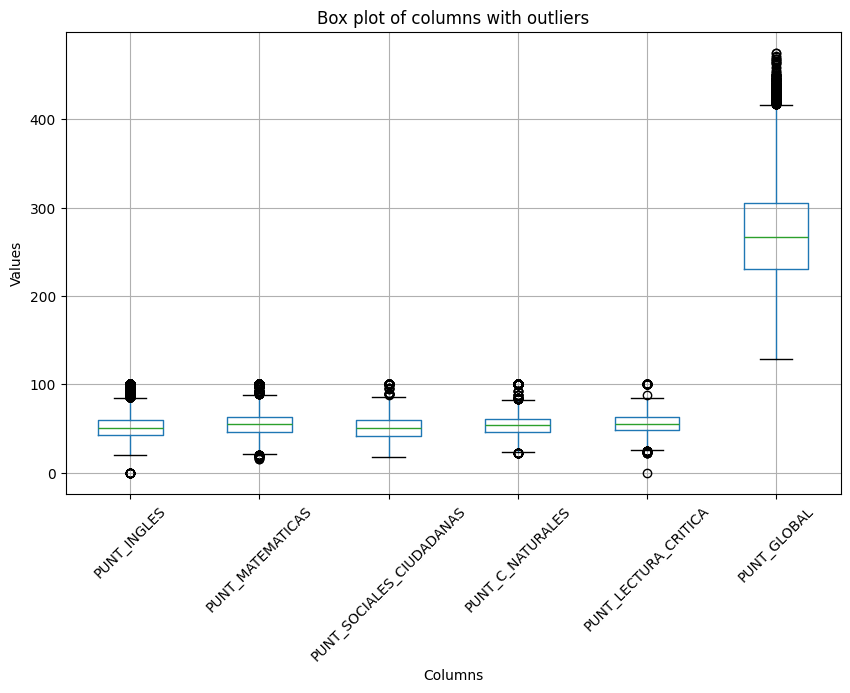

In [12]:
# Specify the columns with outliers
columns_with_outliers = ['PUNT_INGLES', 'PUNT_MATEMATICAS', 'PUNT_SOCIALES_CIUDADANAS', 'PUNT_C_NATURALES', 'PUNT_LECTURA_CRITICA', 'PUNT_GLOBAL']

# Create box plots for each column
plt.figure(figsize=(10, 6))
df_cleaned2[columns_with_outliers].boxplot()
plt.title('Box plot of columns with outliers')
plt.xlabel('Columns')
plt.ylabel('Values')
plt.xticks(rotation=45)
plt.show()

In [13]:
# Remove outliers from specified columns
df_cleaned_no_outliers = df_cleaned2[~outliers[columns_with_outliers].any(axis=1)]

# Print the shape of the dataframe after removing outliers
print("Shape of dataframe after removing outliers:", df_cleaned_no_outliers.shape)

Shape of dataframe after removing outliers: (96253, 51)


#### Handling categorical data

Machine learning modules cannot understand non-numeric data. Therefore we handle the categorical data by one-hot encoding the categories that do not have an ordinal relationship and label encoding the categories that do have an ordinal relationship.

One-hot variables:
- ESTU_TIPODOCUMENTO
- COLE_AREA_UBICACION
- COLE_BILINGUE
- COLE_CALENDARIO
- COLE_CARACTER
- COLE_GENERO
- COLE_JORNADA
- COLE_SEDE_PRINCIPAL
- ESTU_DEPTO_PRESENTACION
- ESTU_DEPTO_RESIDE
- ESTU_ESTADOINVESTIGACION
- ESTU_GENERO
- ESTU_NACIONALIDAD
- ESTU_PAIS_RESIDE
- FAMI_TIENEAUTOMOVIL
- FAMI_TIENECOMPUTADOR
- FAMI_TIENEINTERNET
- FAMI_TIENELAVADORA
- FAMI_PERSONASHOGAR ~~
- FAMI_CUARTOSHOGAR ~~
- FAMI_EDUCACIONMADRE ~~
- FAMI_EDUCACIONPADRE  ~~

Label encoding variables:
- ESTU_FECHANACIMIENTO
- FAMI_ESTRATOVIVIENDA
- DESEMP_INGLES

Others:
- COLE_MCPIO_UBICACION
- ESTU_MCPIO_PRESENTACION
- ESTU_MCPIO_RESIDE

Remove:
- ESTU_CONSECUTIVO
- COLE_DEPTO_UBICACION
- ESTU_ESTUDIANTE
- ESTU_PRIVADO_LIBERTAD

We remove these three variables as they all only have 1 value and will not contribute to the model. ESTU_CONSECUTIVO is removed as it is a code.

In [14]:
df_cleaned_no_outliers.drop(['ESTU_CONSECUTIVO', 'COLE_DEPTO_UBICACION', 'ESTU_ESTUDIANTE', 'ESTU_PRIVADO_LIBERTAD'], axis=1, inplace=True)

C:\Users\Acer\AppData\Local\Temp\ipykernel_26000\3900521874.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned_no_outliers.drop(['ESTU_CONSECUTIVO', 'COLE_DEPTO_UBICACION', 'ESTU_ESTUDIANTE', 'ESTU_PRIVADO_LIBERTAD'], axis=1, inplace=True)


One-hot encoding

In [15]:
# # List of categorical variables to one-hot encode
# categorical_columns = ['ESTU_TIPODOCUMENTO', 'COLE_AREA_UBICACION', 'COLE_BILINGUE', 'COLE_CALENDARIO',
#                        'COLE_CARACTER', 'COLE_GENERO', 'COLE_JORNADA', 'COLE_SEDE_PRINCIPAL',
#                        'ESTU_DEPTO_PRESENTACION', 'ESTU_DEPTO_RESIDE', 'ESTU_ESTADOINVESTIGACION',
#                        'ESTU_GENERO', 'ESTU_NACIONALIDAD', 'ESTU_PAIS_RESIDE', 'FAMI_TIENEAUTOMOVIL',
#                        'FAMI_TIENECOMPUTADOR', 'FAMI_TIENEINTERNET', 'FAMI_TIENELAVADORA']

# # One-hot encode the categorical variables
# df_cleaned_no_outliers_encoded = pd.get_dummies(df_cleaned_no_outliers, columns=categorical_columns, drop_first=True)

In [16]:
# df_cleaned_no_outliers_encoded.shape

In [17]:
# df_cleaned_no_outliers_encoded.dtypes

In [18]:
df_cleaned_no_outliers

,PERIODO,ESTU_TIPODOCUMENTO,COLE_AREA_UBICACION,COLE_BILINGUE,COLE_CALENDARIO,COLE_CARACTER,COLE_COD_DANE_ESTABLECIMIENTO,COLE_COD_DANE_SEDE,COLE_COD_DEPTO_UBICACION,COLE_COD_MCPIO_UBICACION,...,FAMI_TIENECOMPUTADOR,FAMI_TIENEINTERNET,FAMI_TIENELAVADORA,DESEMP_INGLES,PUNT_INGLES,PUNT_MATEMATICAS,PUNT_SOCIALES_CIUDADANAS,PUNT_C_NATURALES,PUNT_LECTURA_CRITICA,PUNT_GLOBAL
0,20194,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.680010e+11,1.680010e+11,68.0,68001.0,...,Si,Si,Si,A2,61.0,64.0,49.0,59.0,63.0,295.0
1,20194,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.680010e+11,1.680010e+11,68.0,68001.0,...,Si,Si,Si,A2,61.0,64.0,49.0,59.0,63.0,295.0
2,20172,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.683070e+11,1.683070e+11,68.0,68307.0,...,No,No,Si,A-,47.0,59.0,64.0,59.0,68.0,307.0
3,20172,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.685470e+11,1.685470e+11,68.0,68547.0,...,No,Si,Si,A-,44.0,45.0,45.0,50.0,46.0,232.0
6,20172,TI,URBANO,N,A,ACADÉMICO,3.680010e+11,3.680010e+11,68.0,68001.0,...,Si,Si,Si,A2,63.0,79.0,69.0,68.0,68.0,352.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105545,20162,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.686890e+11,1.686890e+11,68.0,68689.0,...,No,Si,Si,A-,46.0,47.0,43.0,50.0,41.0,227.0
105548,20172,CC,URBANO,N,A,TÉCNICO/ACADÉMICO,1.683680e+11,1.683680e+11,68.0,68368.0,...,No,No,No,A-,43.0,47.0,52.0,51.0,59.0,258.0
105549,20194,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.683200e+11,1.683200e+11,68.0,68320.0,...,Si,Si,Si,A1,50.0,56.0,36.0,40.0,48.0,227.0
105550,20194,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.683200e+11,1.683200e+11,68.0,68320.0,...,Si,Si,Si,A1,50.0,56.0,36.0,40.0,48.0,227.0


In [19]:
# List of variables
variables = ['ESTU_FECHANACIMIENTO', 'FAMI_CUARTOSHOGAR', 'FAMI_EDUCACIONMADRE',
             'FAMI_EDUCACIONPADRE', 'FAMI_ESTRATOVIVIENDA', 'FAMI_PERSONASHOGAR', 'DESEMP_INGLES']

# Extract unique values for each variable
unique_values = {}
for variable in variables:
    unique_values[variable] = df_cleaned_no_outliers[variable].unique()

# Print unique values for each variable
for variable, values in unique_values.items():
    print(f"Unique values for {variable}:")
    print(values)
    print()

Unique values for ESTU_FECHANACIMIENTO:
['02/12/2002' '18/11/2000' '05/03/2000' ... '03/10/1984' '12/07/1992'
 '26/05/1979']

Unique values for FAMI_CUARTOSHOGAR:
['Tres' 'Cuatro' 'Dos' 'Uno' 'Seis o mas' 'Cinco' 'Seis' 'Siete' 'Nueve'
 'Diez o más' 'Ocho']

Unique values for FAMI_EDUCACIONMADRE:
['Educación profesional incompleta' 'Secundaria (Bachillerato) incompleta'
 'Educación profesional completa' 'Primaria incompleta'
 'Secundaria (Bachillerato) completa' 'Técnica o tecnológica completa'
 'Primaria completa' 'Técnica o tecnológica incompleta' 'Postgrado'
 'Ninguno' 'No sabe' 'No Aplica']

Unique values for FAMI_EDUCACIONPADRE:
['Secundaria (Bachillerato) completa' 'Primaria incompleta'
 'Educación profesional incompleta' 'Técnica o tecnológica incompleta'
 'Técnica o tecnológica completa' 'Secundaria (Bachillerato) incompleta'
 'No sabe' 'Educación profesional completa' 'Primaria completa' 'Ninguno'
 'Postgrado' 'No Aplica']

Unique values for FAMI_ESTRATOVIVIENDA:
['Estrato 3' 

Label encoding

The variables with ordinal ranks are label encoded

In [20]:
from datetime import datetime

# Function to convert date string to numerical value
def convert_to_numerical(date_string):
    date_object = datetime.strptime(date_string, '%d/%m/%Y')
    day = date_object.day
    month = date_object.month
    year = date_object.year
    return day, month, year

# Apply the conversion function to the entire column
df_cleaned_no_outliers[['Day', 'Month', 'Year']] = df_cleaned_no_outliers['ESTU_FECHANACIMIENTO'].apply(lambda x: pd.Series(convert_to_numerical(x)))
df_cleaned_no_outliers.drop(columns=['ESTU_FECHANACIMIENTO'], inplace=True)

C:\Users\Acer\AppData\Local\Temp\ipykernel_26000\49311363.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned_no_outliers[['Day', 'Month', 'Year']] = df_cleaned_no_outliers['ESTU_FECHANACIMIENTO'].apply(lambda x: pd.Series(convert_to_numerical(x)))
C:\Users\Acer\AppData\Local\Temp\ipykernel_26000\49311363.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned_no_outliers[['Day', 'Month', 'Year']] = df_cleaned_no_outliers['ESTU_FECHANACIMIENTO'].apply(lambda x: pd.Series(convert_to_numer

In [21]:
from sklearn.preprocessing import LabelEncoder

# Initialize LabelEncoder
label_encoder = LabelEncoder()

# Define mapping for label encoding
estrato_mapping = {
    'Sin Estrato': 0,
    'Estrato 1': 1,
    'Estrato 2': 2,
    'Estrato 3': 3,
    'Estrato 4': 4,
    'Estrato 5': 5,
    'Estrato 6': 6
}

# Apply label encoding using the defined mapping
df_cleaned_no_outliers['FAMI_ESTRATOVIVIENDA_ENCODED'] = df_cleaned_no_outliers['FAMI_ESTRATOVIVIENDA'].map(estrato_mapping)
df_cleaned_no_outliers.drop(columns=['FAMI_ESTRATOVIVIENDA'], inplace=True)


C:\Users\Acer\AppData\Local\Temp\ipykernel_26000\2819847291.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned_no_outliers['FAMI_ESTRATOVIVIENDA_ENCODED'] = df_cleaned_no_outliers['FAMI_ESTRATOVIVIENDA'].map(estrato_mapping)
C:\Users\Acer\AppData\Local\Temp\ipykernel_26000\2819847291.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned_no_outliers.drop(columns=['FAMI_ESTRATOVIVIENDA'], inplace=True)


In [22]:
# Define the custom mapping dictionary
mapping_dict = {'A-': 1, 'A1': 2, 'A2': 3, 'B1': 4, 'B+': 5}

# Replace the values using the mapping dictionary
df_cleaned_no_outliers['DESEMP_INGLES'] = df_cleaned_no_outliers['DESEMP_INGLES'].map(mapping_dict)

C:\Users\Acer\AppData\Local\Temp\ipykernel_26000\515899654.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned_no_outliers['DESEMP_INGLES'] = df_cleaned_no_outliers['DESEMP_INGLES'].map(mapping_dict)


In [23]:
df_cleaned_no_outliers.head()

,PERIODO,ESTU_TIPODOCUMENTO,COLE_AREA_UBICACION,COLE_BILINGUE,COLE_CALENDARIO,COLE_CARACTER,COLE_COD_DANE_ESTABLECIMIENTO,COLE_COD_DANE_SEDE,COLE_COD_DEPTO_UBICACION,COLE_COD_MCPIO_UBICACION,...,PUNT_INGLES,PUNT_MATEMATICAS,PUNT_SOCIALES_CIUDADANAS,PUNT_C_NATURALES,PUNT_LECTURA_CRITICA,PUNT_GLOBAL,Day,Month,Year,FAMI_ESTRATOVIVIENDA_ENCODED
0,20194,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.680010e+11,1.680010e+11,68.0,68001.0,...,61.0,64.0,49.0,59.0,63.0,295.0,2,12,2002,3
1,20194,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.680010e+11,1.680010e+11,68.0,68001.0,...,61.0,64.0,49.0,59.0,63.0,295.0,2,12,2002,3
2,20172,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.683070e+11,1.683070e+11,68.0,68307.0,...,47.0,59.0,64.0,59.0,68.0,307.0,18,11,2000,1
3,20172,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.685470e+11,1.685470e+11,68.0,68547.0,...,44.0,45.0,45.0,50.0,46.0,232.0,5,3,2000,2
6,20172,TI,URBANO,N,A,ACADÉMICO,3.680010e+11,3.680010e+11,68.0,68001.0,...,63.0,79.0,69.0,68.0,68.0,352.0,29,6,2000,4


#### Scaling

In [24]:
df_visualizations = df_cleaned_no_outliers.copy()

In [25]:
df_visualizations.head()

,PERIODO,ESTU_TIPODOCUMENTO,COLE_AREA_UBICACION,COLE_BILINGUE,COLE_CALENDARIO,COLE_CARACTER,COLE_COD_DANE_ESTABLECIMIENTO,COLE_COD_DANE_SEDE,COLE_COD_DEPTO_UBICACION,COLE_COD_MCPIO_UBICACION,...,PUNT_INGLES,PUNT_MATEMATICAS,PUNT_SOCIALES_CIUDADANAS,PUNT_C_NATURALES,PUNT_LECTURA_CRITICA,PUNT_GLOBAL,Day,Month,Year,FAMI_ESTRATOVIVIENDA_ENCODED
0,20194,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.680010e+11,1.680010e+11,68.0,68001.0,...,61.0,64.0,49.0,59.0,63.0,295.0,2,12,2002,3
1,20194,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.680010e+11,1.680010e+11,68.0,68001.0,...,61.0,64.0,49.0,59.0,63.0,295.0,2,12,2002,3
2,20172,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.683070e+11,1.683070e+11,68.0,68307.0,...,47.0,59.0,64.0,59.0,68.0,307.0,18,11,2000,1
3,20172,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.685470e+11,1.685470e+11,68.0,68547.0,...,44.0,45.0,45.0,50.0,46.0,232.0,5,3,2000,2
6,20172,TI,URBANO,N,A,ACADÉMICO,3.680010e+11,3.680010e+11,68.0,68001.0,...,63.0,79.0,69.0,68.0,68.0,352.0,29,6,2000,4


In [26]:
df_cleaned_no_outliers.dtypes

PERIODO                            int64
ESTU_TIPODOCUMENTO                object
COLE_AREA_UBICACION               object
COLE_BILINGUE                     object
COLE_CALENDARIO                   object
COLE_CARACTER                     object
COLE_COD_DANE_ESTABLECIMIENTO    float64
COLE_COD_DANE_SEDE               float64
COLE_COD_DEPTO_UBICACION         float64
COLE_COD_MCPIO_UBICACION         float64
COLE_CODIGO_ICFES                float64
COLE_GENERO                       object
COLE_JORNADA                      object
COLE_MCPIO_UBICACION              object
COLE_NATURALEZA                   object
COLE_NOMBRE_ESTABLECIMIENTO       object
COLE_NOMBRE_SEDE                  object
COLE_SEDE_PRINCIPAL               object
ESTU_COD_DEPTO_PRESENTACION      float64
ESTU_COD_MCPIO_PRESENTACION      float64
ESTU_COD_RESIDE_DEPTO            float64
ESTU_COD_RESIDE_MCPIO            float64
ESTU_DEPTO_PRESENTACION           object
ESTU_DEPTO_RESIDE                 object
ESTU_ESTADOINVES

In [27]:
from sklearn.preprocessing import StandardScaler

numerical_columns = df_cleaned_no_outliers.select_dtypes(include=['float64', 'int64']).columns

scaler = StandardScaler()

# Fit and transform the numerical data
df_cleaned_no_outliers[numerical_columns] = scaler.fit_transform(df_cleaned_no_outliers[numerical_columns])


C:\Users\Acer\AppData\Local\Temp\ipykernel_26000\347738380.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned_no_outliers[numerical_columns] = scaler.fit_transform(df_cleaned_no_outliers[numerical_columns])


In [28]:
df_cleaned_no_outliers.head()

,PERIODO,ESTU_TIPODOCUMENTO,COLE_AREA_UBICACION,COLE_BILINGUE,COLE_CALENDARIO,COLE_CARACTER,COLE_COD_DANE_ESTABLECIMIENTO,COLE_COD_DANE_SEDE,COLE_COD_DEPTO_UBICACION,COLE_COD_MCPIO_UBICACION,...,PUNT_INGLES,PUNT_MATEMATICAS,PUNT_SOCIALES_CIUDADANAS,PUNT_C_NATURALES,PUNT_LECTURA_CRITICA,PUNT_GLOBAL,Day,Month,Year,FAMI_ESTRATOVIVIENDA_ENCODED
0,1.019336,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,-0.722391,-0.724270,0.0,-1.092927,...,0.771142,0.797152,-0.179418,0.527407,0.783308,0.558148,-1.553745,1.578065,0.279941,0.873615
1,1.019336,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,-0.722391,-0.724270,0.0,-1.092927,...,0.771142,0.797152,-0.179418,0.527407,0.783308,0.558148,-1.553745,1.578065,0.279941,0.873615
2,-0.546329,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,-0.719049,-0.720936,0.0,0.091363,...,-0.400378,0.375776,1.094614,0.527407,1.278968,0.798753,0.263953,1.287491,0.014609,-0.974901
3,-0.546329,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,-0.716428,-0.718321,0.0,1.020217,...,-0.651418,-0.804077,-0.519160,-0.339865,-0.901934,-0.705030,-1.212926,-1.037101,0.014609,-0.050643
6,-0.546329,TI,URBANO,N,A,ACADÉMICO,1.462081,1.454794,0.0,-1.092927,...,0.938502,2.061279,1.519292,1.394678,1.278968,1.701023,1.513621,-0.165379,0.014609,1.797873


## Tarea 3. Exploración de datos:

In [29]:
df_visualizations.head()

,PERIODO,ESTU_TIPODOCUMENTO,COLE_AREA_UBICACION,COLE_BILINGUE,COLE_CALENDARIO,COLE_CARACTER,COLE_COD_DANE_ESTABLECIMIENTO,COLE_COD_DANE_SEDE,COLE_COD_DEPTO_UBICACION,COLE_COD_MCPIO_UBICACION,...,PUNT_INGLES,PUNT_MATEMATICAS,PUNT_SOCIALES_CIUDADANAS,PUNT_C_NATURALES,PUNT_LECTURA_CRITICA,PUNT_GLOBAL,Day,Month,Year,FAMI_ESTRATOVIVIENDA_ENCODED
0,20194,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.680010e+11,1.680010e+11,68.0,68001.0,...,61.0,64.0,49.0,59.0,63.0,295.0,2,12,2002,3
1,20194,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.680010e+11,1.680010e+11,68.0,68001.0,...,61.0,64.0,49.0,59.0,63.0,295.0,2,12,2002,3
2,20172,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.683070e+11,1.683070e+11,68.0,68307.0,...,47.0,59.0,64.0,59.0,68.0,307.0,18,11,2000,1
3,20172,TI,URBANO,N,A,TÉCNICO/ACADÉMICO,1.685470e+11,1.685470e+11,68.0,68547.0,...,44.0,45.0,45.0,50.0,46.0,232.0,5,3,2000,2
6,20172,TI,URBANO,N,A,ACADÉMICO,3.680010e+11,3.680010e+11,68.0,68001.0,...,63.0,79.0,69.0,68.0,68.0,352.0,29,6,2000,4


In [30]:
df_visualizations.columns

Index(['PERIODO', 'ESTU_TIPODOCUMENTO', 'COLE_AREA_UBICACION', 'COLE_BILINGUE',
       'COLE_CALENDARIO', 'COLE_CARACTER', 'COLE_COD_DANE_ESTABLECIMIENTO',
       'COLE_COD_DANE_SEDE', 'COLE_COD_DEPTO_UBICACION',
       'COLE_COD_MCPIO_UBICACION', 'COLE_CODIGO_ICFES', 'COLE_GENERO',
       'COLE_JORNADA', 'COLE_MCPIO_UBICACION', 'COLE_NATURALEZA',
       'COLE_NOMBRE_ESTABLECIMIENTO', 'COLE_NOMBRE_SEDE',
       'COLE_SEDE_PRINCIPAL', 'ESTU_COD_DEPTO_PRESENTACION',
       'ESTU_COD_MCPIO_PRESENTACION', 'ESTU_COD_RESIDE_DEPTO',
       'ESTU_COD_RESIDE_MCPIO', 'ESTU_DEPTO_PRESENTACION', 'ESTU_DEPTO_RESIDE',
       'ESTU_ESTADOINVESTIGACION', 'ESTU_GENERO', 'ESTU_MCPIO_PRESENTACION',
       'ESTU_MCPIO_RESIDE', 'ESTU_NACIONALIDAD', 'ESTU_PAIS_RESIDE',
       'FAMI_CUARTOSHOGAR', 'FAMI_EDUCACIONMADRE', 'FAMI_EDUCACIONPADRE',
       'FAMI_PERSONASHOGAR', 'FAMI_TIENEAUTOMOVIL', 'FAMI_TIENECOMPUTADOR',
       'FAMI_TIENEINTERNET', 'FAMI_TIENELAVADORA', 'DESEMP_INGLES',
       'PUNT_INGLES', 'P

### Desempeño de los estudiantes en cada año

In [31]:
df_visualizations['PERIODO'].unique()

array([20194, 20172, 20162, 20181, 20171, 20161, 20191], dtype=int64)

In [32]:
notas_2019 = df_visualizations[(df_visualizations['PERIODO'] == 20194) | (df['PERIODO'] == 20191)]
notas_2018 = df_visualizations[(df_visualizations['PERIODO'] == 20181)]
notas_2017 = df_visualizations[(df_visualizations['PERIODO'] == 20172) | (df['PERIODO'] == 20171)]
notas_2016 = df_visualizations[(df_visualizations['PERIODO'] == 20162) | (df['PERIODO'] == 20161)]

C:\Users\Acer\AppData\Local\Temp\ipykernel_26000\3807267208.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  notas_2019 = df_visualizations[(df_visualizations['PERIODO'] == 20194) | (df['PERIODO'] == 20191)]
C:\Users\Acer\AppData\Local\Temp\ipykernel_26000\3807267208.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  notas_2017 = df_visualizations[(df_visualizations['PERIODO'] == 20172) | (df['PERIODO'] == 20171)]
C:\Users\Acer\AppData\Local\Temp\ipykernel_26000\3807267208.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  notas_2016 = df_visualizations[(df_visualizations['PERIODO'] == 20162) | (df['PERIODO'] == 20161)]


In [33]:
fig = go.Figure()
fig.add_trace(go.Box(y = notas_2016['PUNT_GLOBAL'], name = '2016', marker_color='fuchsia'))
fig.add_trace(go.Box(y = notas_2017['PUNT_GLOBAL'], name = '2017', marker_color = 'limegreen'))
fig.add_trace(go.Box(y = notas_2018['PUNT_GLOBAL'], name = '2018', marker_color = 'salmon'))
fig.add_trace(go.Box(y = notas_2019['PUNT_GLOBAL'], name = '2019', marker_color = 'teal'))
fig.update_layout(title_text="Desempeño global por año")

fig.show()

### Desempeño de los estudiantes por colegio bilingüe

In [34]:
df_visualizations['COLE_BILINGUE'].unique()

array(['N', 'S'], dtype=object)

In [35]:
notas_no = df_visualizations[(df_visualizations['COLE_BILINGUE'] == 'N')]
notas_si = df_visualizations[(df_visualizations['COLE_BILINGUE'] == 'S')]

In [36]:
fig = go.Figure()
fig.add_trace(go.Box(y = notas_no['PUNT_GLOBAL'], name = 'No Bilingüe', marker_color='fuchsia'))
fig.add_trace(go.Box(y = notas_si['PUNT_GLOBAL'], name = 'Bilingüe', marker_color = 'limegreen'))
fig.update_layout(title_text="Desempeño global por tipo de colegio")

fig.show()

### Desempeño por tipo de calendario académico

In [37]:
df_visualizations['COLE_CALENDARIO'].unique()

array(['A', 'OTRO', 'B'], dtype=object)

In [38]:
notas_a = df_visualizations[(df_visualizations['COLE_CALENDARIO'] == 'A')]
notas_b = df_visualizations[(df_visualizations['COLE_CALENDARIO'] == 'B')]
notas_otro = df_visualizations[(df_visualizations['COLE_CALENDARIO'] == 'OTRO')]

In [39]:
fig = go.Figure()
fig.add_trace(go.Box(y = notas_a['PUNT_GLOBAL'], name = 'Calendario A', marker_color='fuchsia'))
fig.add_trace(go.Box(y = notas_b['PUNT_GLOBAL'], name = 'Calendario B', marker_color = 'limegreen'))
fig.add_trace(go.Box(y = notas_otro['PUNT_GLOBAL'], name = 'Otro', marker_color = 'salmon'))
fig.update_layout(title_text="Desempeño global por calendario académico")

fig.show()

### Desempeño por carácter del colegio

In [40]:
df_visualizations['COLE_CARACTER'].unique()

array(['TÉCNICO/ACADÉMICO', 'ACADÉMICO', 'TÉCNICO', 'NO APLICA'],
      dtype=object)

In [41]:
notas_ambas = df_visualizations[(df_visualizations['COLE_CARACTER'] == 'TÉCNICO/ACADÉMICO')]
notas_academico = df_visualizations[(df_visualizations['COLE_CARACTER'] == 'ACADÉMICO')]
notas_tecnico = df_visualizations[(df_visualizations['COLE_CARACTER'] == 'TÉCNICO')]

In [42]:
fig = go.Figure()
fig.add_trace(go.Box(y = notas_ambas['PUNT_GLOBAL'], name = 'Técnico y Académico', marker_color='fuchsia'))
fig.add_trace(go.Box(y = notas_academico['PUNT_GLOBAL'], name = 'Académico', marker_color = 'limegreen'))
fig.add_trace(go.Box(y = notas_tecnico['PUNT_GLOBAL'], name = 'Técnico', marker_color = 'salmon'))
fig.update_layout(title_text="Desempeño global por tipo de colegio")

fig.show()

### Desempeño por si el colegio es mixto o solo un género

In [43]:
df_visualizations['COLE_GENERO'].unique()

array(['MIXTO', 'FEMENINO', 'MASCULINO'], dtype=object)

In [44]:
notas_mixto = df_visualizations[(df_visualizations['COLE_GENERO'] == 'MIXTO')]
notas_femenino = df_visualizations[(df_visualizations['COLE_GENERO'] == 'FEMENINO')]
notas_masculino = df_visualizations[(df_visualizations['COLE_GENERO'] == 'MASCULINO')]

In [45]:
fig = go.Figure()
fig.add_trace(go.Box(y = notas_mixto['PUNT_GLOBAL'], name = 'Mixto', marker_color='fuchsia'))
fig.add_trace(go.Box(y = notas_femenino['PUNT_GLOBAL'], name = 'Femenino', marker_color = 'limegreen'))
fig.add_trace(go.Box(y = notas_masculino['PUNT_GLOBAL'], name = 'Masculino', marker_color = 'salmon'))
fig.update_layout(title_text="Desempeño global por colegio mixto o diferenciado")

fig.show()

### Desempeño por tipo de jornada

In [46]:
df_visualizations['COLE_JORNADA'].unique()

array(['MAÑANA', 'TARDE', 'COMPLETA', 'SABATINA', 'NOCHE', 'UNICA'],
      dtype=object)

In [47]:
notas_manana = df_visualizations[(df_visualizations['COLE_JORNADA'] == 'MAÑANA')]
notas_tarde = df_visualizations[(df_visualizations['COLE_JORNADA'] == 'TARDE')]
notas_noche = df_visualizations[(df_visualizations['COLE_JORNADA'] == 'NOCHE')]
notas_sabatina = df_visualizations[(df_visualizations['COLE_JORNADA'] == 'SABATINA')]
notas_unica = df_visualizations[(df_visualizations['COLE_JORNADA'] == 'UNICA')]
notas_completa = df_visualizations[(df_visualizations['COLE_JORNADA'] == 'COMPLETA')]

In [48]:
fig = go.Figure()
fig.add_trace(go.Box(y = notas_manana['PUNT_GLOBAL'], name = 'Mañana', marker_color='fuchsia'))
fig.add_trace(go.Box(y = notas_tarde['PUNT_GLOBAL'], name = 'Tarde', marker_color = 'limegreen'))
fig.add_trace(go.Box(y = notas_noche['PUNT_GLOBAL'], name = 'Noche', marker_color = 'salmon'))
fig.add_trace(go.Box(y = notas_sabatina['PUNT_GLOBAL'], name = 'Sabatina', marker_color = 'teal'))
fig.add_trace(go.Box(y = notas_unica['PUNT_GLOBAL'], name = 'Única', marker_color = 'darkslategrey'))
fig.add_trace(go.Box(y = notas_completa['PUNT_GLOBAL'], name = 'Completa', marker_color = 'goldenrod'))
fig.update_layout(title_text="Desempeño global por tipo de jornada")

fig.show()

### Desempeño por naturaleza del colegio

In [49]:
df_visualizations['COLE_NATURALEZA'].unique()

array(['OFICIAL', 'NO OFICIAL'], dtype=object)

In [50]:
notas_oficial = df_visualizations[(df_visualizations['COLE_NATURALEZA'] == 'OFICIAL')]
notas_nooficial = df_visualizations[(df_visualizations['COLE_NATURALEZA'] == 'NO OFICIAL')]

In [51]:
fig = go.Figure()
fig.add_trace(go.Box(y = notas_oficial['PUNT_GLOBAL'], name = 'Oficial', marker_color='fuchsia'))
fig.add_trace(go.Box(y = notas_nooficial['PUNT_GLOBAL'], name = 'No Oficial', marker_color = 'limegreen'))
fig.update_layout(title_text="Desempeño global por naturaleza del colegio")

fig.show()

### Desempeño por género del estudiante

In [52]:
df_visualizations['ESTU_GENERO'].unique()

array(['F', 'M'], dtype=object)

In [53]:
notas_mujeeres = df_visualizations[(df_visualizations['ESTU_GENERO'] == 'F')]
notas_hombres = df_visualizations[(df_visualizations['ESTU_GENERO'] == 'M')]

In [54]:
fig = go.Figure()
fig.add_trace(go.Box(y = notas_mujeeres['PUNT_GLOBAL'], name = 'Mujeres', marker_color='fuchsia'))
fig.add_trace(go.Box(y = notas_hombres['PUNT_GLOBAL'], name = 'Hombres', marker_color = 'limegreen'))
fig.update_layout(title_text="Desempeño global por género")

fig.show()

### Desempeño por estrato

In [55]:
df_visualizations['FAMI_ESTRATOVIVIENDA_ENCODED'].unique()

array([3, 1, 2, 4, 5, 0, 6], dtype=int64)

In [56]:
notas_0 = df_visualizations[(df_visualizations['FAMI_ESTRATOVIVIENDA_ENCODED'] == 0)]
notas_1 = df_visualizations[(df_visualizations['FAMI_ESTRATOVIVIENDA_ENCODED'] == 1)]
notas_2 = df_visualizations[(df_visualizations['FAMI_ESTRATOVIVIENDA_ENCODED'] == 2)]
notas_3 = df_visualizations[(df_visualizations['FAMI_ESTRATOVIVIENDA_ENCODED'] == 3)]
notas_4 = df_visualizations[(df_visualizations['FAMI_ESTRATOVIVIENDA_ENCODED'] == 4)]
notas_5 = df_visualizations[(df_visualizations['FAMI_ESTRATOVIVIENDA_ENCODED'] == 5)]
notas_6 = df_visualizations[(df_visualizations['FAMI_ESTRATOVIVIENDA_ENCODED'] == 6)]

In [57]:
fig = go.Figure()
fig.add_trace(go.Box(y = notas_0['PUNT_GLOBAL'], name = 'Estrato 0', marker_color='fuchsia'))
fig.add_trace(go.Box(y = notas_1['PUNT_GLOBAL'], name = 'Estrato 1', marker_color = 'limegreen'))
fig.add_trace(go.Box(y = notas_2['PUNT_GLOBAL'], name = 'Estrato 2', marker_color = 'salmon'))
fig.add_trace(go.Box(y = notas_3['PUNT_GLOBAL'], name = 'Estrato 3', marker_color = 'teal'))
fig.add_trace(go.Box(y = notas_4['PUNT_GLOBAL'], name = 'Estrato 4', marker_color = 'darkslategrey'))
fig.add_trace(go.Box(y = notas_5['PUNT_GLOBAL'], name = 'Estrato 5', marker_color = 'goldenrod'))
fig.add_trace(go.Box(y = notas_6['PUNT_GLOBAL'], name = 'Estrato 6', marker_color = 'darkviolet'))
fig.update_layout(title_text="Desempeño global por estrato")

fig.show()

### Desempeño por nivel de inglés

In [58]:
df['DESEMP_INGLES'].unique()

array(['A2', 'A-', 'A1', 'B1', 'B+'], dtype=object)

In [59]:
notas_a2 = df[(df['DESEMP_INGLES'] == 'A2')]
notas_a_ = df[(df['DESEMP_INGLES'] == 'A-')]
notas_a1 = df[(df['DESEMP_INGLES'] == 'A1')]
notas_b1 = df[(df['DESEMP_INGLES'] == 'B1')]
notas_b_ = df[(df['DESEMP_INGLES'] == 'B+')]

In [60]:
fig = go.Figure()
fig.add_trace(go.Box(y = notas_a2['PUNT_GLOBAL'], name = 'A2', marker_color='fuchsia'))
fig.add_trace(go.Box(y = notas_a_['PUNT_GLOBAL'], name = 'A-', marker_color = 'limegreen'))
fig.add_trace(go.Box(y = notas_a1['PUNT_GLOBAL'], name = 'A1', marker_color = 'salmon'))
fig.add_trace(go.Box(y = notas_b1['PUNT_GLOBAL'], name = 'B1', marker_color = 'teal'))
fig.add_trace(go.Box(y = notas_b_['PUNT_GLOBAL'], name = 'B+', marker_color = 'darkslategrey'))

fig.update_layout(title_text="Desempeño global por tipo de jornada")

fig.show()

In [61]:
df_visualizations['Year']

0         2002
1         2002
2         2000
3         2000
6         2000
          ... 
105545    1999
105548    1998
105549    2003
105550    2003
105551    1997
Name: Year, Length: 96253, dtype: int64

In [62]:
# Paso 1: Encuentra el valor mínimo de la columna 'Year'
df2 = df_visualizations.copy()

min_year = df2['Year'].min()

# Paso 2: Encuentra el índice de la fila que contiene este valor mínimo
index_min_year = df2[df2['Year'] == min_year].index

# Paso 3: Elimina esa fila usando el índice encontrado
df2 = df2.drop(index_min_year)

In [63]:
import plotly.express as px

fig = px.scatter(x=df2['Year'], y=df2['PUNT_GLOBAL'])
fig.update_layout(
    title="Desempeño por año de nacimiento",
    xaxis_title="Año de nacimiento",
    yaxis_title="Puntaje Global"
)
fig.update_traces(marker=dict(color='salmon'))


fig.show()

### Histograma Bilingüe y No Bilingüe

In [64]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=notas_no['PUNT_GLOBAL'], histnorm='probability density', marker_color='fuchsia', name = 'No Bilingüe'))
fig.add_trace(go.Histogram(x=notas_si['PUNT_GLOBAL'], histnorm='probability density', marker_color='limegreen', name = 'Bilinüe'))

# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.update_layout(title_text="Desempeño por tipo de colegio")

fig.show()

### Histograma Mujeres y Hombres

In [65]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=notas_mujeeres['PUNT_GLOBAL'], histnorm='probability density', marker_color='fuchsia', name = 'Mujeres'))
fig.add_trace(go.Histogram(x=notas_hombres['PUNT_GLOBAL'], histnorm='probability density', marker_color='limegreen', name = 'Hombres'))

# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.update_layout(title_text="Desempeño por tipo de colegio")

fig.show()

### Histograma Calendario

In [66]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=notas_a['PUNT_GLOBAL'], histnorm='probability density', marker_color='fuchsia', name = 'Calendario A'))
fig.add_trace(go.Histogram(x=notas_b['PUNT_GLOBAL'], histnorm='probability density', marker_color='limegreen', name = 'Calendario B'))
fig.add_trace(go.Histogram(x=notas_otro['PUNT_GLOBAL'], histnorm='probability density', marker_color='yellow', name = 'Otro'))

# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.update_layout(title_text="Desempeño por calendario del colegio")

fig.show()

### Histograma Calendario

In [67]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=notas_academico['PUNT_GLOBAL'], histnorm='probability density', marker_color='fuchsia', name = 'Académico'))
fig.add_trace(go.Histogram(x=notas_tecnico['PUNT_GLOBAL'], histnorm='probability density', marker_color='limegreen', name = 'Técnico'))
fig.add_trace(go.Histogram(x=notas_ambas['PUNT_GLOBAL'], histnorm='probability density', marker_color='yellow', name = 'Ambas'))

# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.update_layout(title_text="Desempeño por tipo de colegio")

fig.show()

### Histograma Colegio Mixto o Diferenciado

In [68]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=notas_mixto['PUNT_GLOBAL'], histnorm='probability density', marker_color='fuchsia', name = 'Mixto'))
fig.add_trace(go.Histogram(x=notas_femenino['PUNT_GLOBAL'], histnorm='probability density', marker_color='limegreen', name = 'Femenino'))
fig.add_trace(go.Histogram(x=notas_masculino['PUNT_GLOBAL'], histnorm='probability density', marker_color='yellow', name = 'Masculino'))

# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.7)
fig.update_layout(title_text="Desempeño por colegio mixto o diferenciado")

fig.show()

### Violin plot Bilingüe y No Bilingüe - OMITIR, NO FUNCIONAN

In [69]:
fig = go.Figure()

fig.add_trace(go.Violin(
                        y=df_visualizations['PUNT_GLOBAL'][ df_visualizations['COLE_BILINGUE'] == 'S' ],
                        legendgroup='Bilingüe', scalegroup='Yes', name='Bilingüe',
                        side='negative',
                        line_color='blue')
             )
fig.add_trace(go.Violin(x=df_visualizations['COLE_BILINGUE'][ df_visualizations['COLE_BILINGUE'] == 'N' ],
                        y=df_visualizations['PUNT_GLOBAL'][ df_visualizations['COLE_BILINGUE'] == 'N' ],
                        legendgroup='No Bilingüe', scalegroup='Yes', name='No Bilingüe',
                        side='positive',
                        line_color='orange')
             )
fig.update_traces(meanline_visible=True)
fig.update_layout(violingap=0, violinmode='overlay')
fig.show()

In [70]:
fig = go.Figure()

# Añadir el diagrama de violín para los colegios bilingües
fig.add_trace(go.Violin(y=notas_si['PUNT_GLOBAL'],
                        name='Bilingüe',
                        box_visible=True,
                        meanline_visible=True))

# Añadir el diagrama de violín para los colegios no bilingües
fig.add_trace(go.Violin(y=notas_no['PUNT_GLOBAL'],
                        name='No Bilingüe',
                        box_visible=True,
                        meanline_visible=True))

# Actualizar el diseño del gráfico
fig.update_layout(title='Comparación del Puntaje Global entre Colegios Bilingües y No Bilingües',
                  yaxis_title='Puntaje Global',
                  violinmode='group')

fig.show()

In [71]:
fig = go.Figure()

# Añadir el diagrama de violín para los colegios bilingües en el lado izquierdo
fig.add_trace(go.Violin(y=notas_si['PUNT_GLOBAL'],
                        name='Bilingüe',
                        side='negative',
                        box_visible=True,
                        meanline_visible=True,
                        line_color='blue'))

# Añadir el diagrama de violín para los colegios no bilingües en el lado derecho
fig.add_trace(go.Violin(y=notas_no['PUNT_GLOBAL'],
                        name='No Bilingüe',
                        side='positive',
                        box_visible=True,
                        meanline_visible=True,
                        line_color='red'))

# Actualizar el diseño del gráfico
fig.update_layout(title='Comparación del Puntaje Global entre Colegios Bilingües y No Bilingües',
                  yaxis_title='Puntaje Global',
                  violinmode='overlay')

fig.show()


In [72]:
fig = go.Figure()

# Añadir el diagrama de violín para ambos grupos
fig.add_trace(go.Violin(y=notas_si['PUNT_GLOBAL'],
                        x=['Bilingüe'] * len(notas_si),
                        name='Bilingüe',
                        box_visible=True,
                        meanline_visible=True,
                        line_color='blue'))

fig.add_trace(go.Violin(y=notas_no['PUNT_GLOBAL'],
                        x=['No Bilingüe'] * len(notas_no),
                        name='No Bilingüe',
                        box_visible=True,
                        meanline_visible=True,
                        line_color='red'))

# Actualizar el diseño del gráfico
fig.update_layout(title='Comparación del Puntaje Global entre Colegios Bilingües y No Bilingües',
                  yaxis_title='Puntaje Global',
                  violinmode='group')

fig.show()

In [73]:
provisional = df_visualizations[['COLE_BILINGUE', 'PUNT_GLOBAL']].copy()

In [74]:
provisional.head()

,COLE_BILINGUE,PUNT_GLOBAL
0,N,295.0
1,N,295.0
2,N,307.0
3,N,232.0
6,N,352.0
